# Run open area calculations and related calculations on Windhoek buildings and city blocks


In [ ]:
## NOTES: original geopandas install via pip is corrupted. sjoin does not work
##        this should fix
%load_ext autoreload
%autoreload 2
%matplotlib inline

!apt update
!apt upgrade
!apt install gdal-bin python-gdal python3-gdal 
# Install rtree - Geopandas requirment
!apt install python3-rtree 
# Install Geopandas
!pip install git+git://github.com/geopandas/geopandas.git
# Install descartes - Geopandas requirment
!pip install descartes 

Get:1 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Ign:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Get:3 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran35/ InRelease [3,626 B]
Hit:4 http://ppa.launchpad.net/graphics-drivers/ppa/ubuntu bionic InRelease
Hit:5 http://archive.ubuntu.com/ubuntu bionic InRelease
Ign:6 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Hit:7 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release
Hit:8 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release
Get:9 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Get:10 http://ppa.launchpad.net/marutter/c2d4u3.5/ubuntu bionic InRelease [15.4 kB]
Get:11 http://security.ubuntu.com/ubuntu bionic-security/restricted amd64 Packages [89.9 kB]
Get:12 http://security.ubuntu.com/ubuntu bionic-security/main amd64

In [ ]:
%cd /content/
!git clone https://github.com/CooperNederhood/namib_landuse.git
%cd /content/namib_landuse
%ls
!git pull

/content
Cloning into 'namib_landuse'...
remote: Enumerating objects: 20, done.
remote: Counting objects: 100% (20/20), done.
remote: Compressing objects: 100% (14/14), done.
remote: Total 20 (delta 8), reused 12 (delta 4), pack-reused 0
Unpacking objects: 100% (20/20), done.
/content/namib_landuse
land_utils.py  LICENSE  README.md
Already up to date.


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/', force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive/


In [ ]:
import sys
import geopandas as gpd 
from pathlib import Path
sys.path.insert(0, "/content/namib_landuse/")
import land_utils

################################################################################
# THIS IS A LOCAL PATH AND WILL NEED TO BE RESET
DATA_ROOT = "/content/gdrive/My Drive/chicago_urban/namib_landuse_remote/raw_data"
################################################################################

blocks_file = "Windhoek_existing_blocks.geojson"
buildings_file = "Windhoek_buildings.geojson"

buildings_path = Path(DATA_ROOT) / "Windhoek" / buildings_file
blocks_path = Path(DATA_ROOT) / "Windhoek" / blocks_file 

In [ ]:
# (1) Load the files. There is a file for the buildings and a file for the city blocks
bldgs = gpd.read_file(buildings_path)
blocks = gpd.read_file(blocks_path)

In [ ]:
# (2) Spatial join the buildings with the blocks so we know which block contains each building
bldgs = land_utils.add_block_id_to_buildings(bldgs, blocks)

In [ ]:
# (3) Calculate block area, area of block covered by buildings, and the density of buildings within a block 
# note: we reproject to coordinate reference system (CRS) that allows for calculation of distances, rather than using a CRS that uses lat/lon
bldgs, blocks = land_utils.convert_crs_4326_to_3395([bldgs, blocks])
blocks = land_utils.building_density_per_block(bldgs, blocks)

/usr/local/lib/python3.6/dist-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [ ]:
# (4) Calculate the max-min building distance
blocks = land_utils.max_building_distance_per_block(bldgs, blocks)

In [ ]:
# (5) Save the buildings merged w/ block file and 
#     the block file, to our processed data folder
blocks = blocks.to_crs("EPSG:4326")
bldgs = bldgs.to_crs("EPSG:4326")

out_dir = Path(DATA_ROOT).parent / "processed_data" / "Windhoek"
out_dir.mkdir(parents=True, exist_ok=True)

blocks.to_file(str(out_dir / blocks_file), driver='GeoJSON')
bldgs.to_file(str(out_dir / buildings_file), driver='GeoJSON')

In [ ]:
print(str(out_dir / buildings_file))
blocks.iloc[0]

/content/gdrive/My Drive/chicago_urban/namib_landuse_remote/processed_data/Windhoek/Windhoek_buildings.geojson


block_id                                             NAM.5.10_1_0
geometry        POLYGON ((17.06935882568359 -22.68822288513101...
bldg_area                                                       0
bldg_count                                                      0
block_area                                                5191.54
bldg_density                                                    0
max_dist                                                  115.867
Name: 0, dtype: object

# BELOW THIS IS SCRATCH WORK AND WILL BE DELETED

In [ ]:
blocks.sort_values(by='bldg_density', ascending=False, inplace=True)

In [ ]:
#selection = blocks[(blocks['bldg_density']<1.0) & (blocks['bldg_density']>0.0) & (blocks['max_dist']>1000)]
selection_gt500 = blocks[(blocks['bldg_density']<1.0) & (blocks['bldg_density']>0.0) & (blocks['max_dist']>500) & (blocks['max_dist']<1000)]
selection_gt250 = blocks[(blocks['bldg_density']<1.0) & (blocks['bldg_density']>0.0) & (blocks['max_dist']>250) & (blocks['max_dist']<=500)]

selection = selection_gt250
print(selection.shape)
selection

(175, 7)


,block_id,geometry,bldg_area,bldg_count,block_area,bldg_density,max_dist
670,NAM.5.10_1_670,"POLYGON ((1900120.946 -2567416.305, 1900175.62...",25193.002248,102.0,7.416869e+04,0.339672,287.027291
3563,NAM.5.6_1_99,"POLYGON ((1898585.503 -2555821.980, 1898585.50...",45169.517711,728.0,1.340366e+05,0.336994,254.003668
1193,NAM.5.10_1_1193,"POLYGON ((1900902.024 -2564936.644, 1900911.69...",73852.832263,109.0,2.209672e+05,0.334225,388.924816
5015,NAM.5.1_1_56,"POLYGON ((1898957.176 -2557281.232, 1898965.26...",9887.655872,113.0,2.986760e+04,0.331050,254.878426
2430,NAM.5.8_1_767,"POLYGON ((1901444.696 -2565301.277, 1901432.45...",46673.132076,53.0,1.456663e+05,0.320411,267.955307
...,...,...,...,...,...,...,...
339,NAM.5.10_1_339,"POLYGON ((1900114.172 -2574636.087, 1900094.81...",26.996352,1.0,4.117383e+05,0.000066,451.524214
395,NAM.5.10_1_395,"POLYGON ((1895566.638 -2573896.822, 1895536.40...",43.189348,3.0,7.289248e+05,0.000059,424.336722
230,NAM.5.10_1_230,"POLYGON ((1892831.862 -2570323.607, 1892840.43...",21.387947,1.0,4.589718e+05,0.000047,413.680843
3120,NAM.5.7_1_0,"POLYGON ((1891268.864 -2559139.968, 1891297.52...",37.136396,2.0,1.234202e+06,0.000030,327.835640


In [ ]:
def plot(bldgs, blocks, block_id=None,  **kwargs):

  if block_id is not None:
    ax = blocks[ blocks['block_id']==block_id ].plot(**kwargs)
    bldgs[ bldgs['block_id']==block_id ].plot(ax=ax, color='black', alpha=0.9)
  else:
    ax = blocks.plot(**kwargs)
    bldgs.plot(ax=ax, color='black', alpha=0.9)    
  return ax 

In [ ]:
#i = selection.shape[0]
#b = selection['block_id'].iloc[i]
#ax = plot(bldgs, blocks, figsize=(20,20))

In [ ]:
#ax = blocks.plot(figsize=(20,20))
#selection.plot(ax=ax, color='red')

In [ ]:
import json

from bokeh.io import output_file, show, output_notebook
from bokeh.models import GeoJSONDataSource
from bokeh.plotting import figure
from bokeh.sampledata.sample_geojson import geojson

output_notebook()

data = json.loads(geojson)
for i in range(len(data['features'])):
    data['features'][i]['properties']['Color'] = ['blue', 'red'][i%2]

#geo_source = GeoJSONDataSource(geojson=json.dumps(data))
geo_source = GeoJSONDataSource(geojson=blocks.to_json())

TOOLTIPS = [
    ('Organisation', '@OrganisationName')
]

# p = figure(background_fill_color="lightgrey", tooltips=TOOLTIPS)
# p.circle(x='x', y='y', size=15, color='Color', alpha=0.7, source=geo_source)


In [ ]:
p = figure(background_fill_color="lightgrey", tooltips=TOOLTIPS)
#p.patches(xs='x', ys='y',  alpha=0.7, source=geo_source)
# Add patch renderer to figure.
states = p.patches('xs','ys', source = geo_source,
                   fill_color = None,
                   line_width = 0.25, 
                   fill_alpha = 1)

In [ ]:
show(p)

In [ ]:
geo_source.properties()

{'callback',
 'geojson',
 'js_event_callbacks',
 'js_property_callbacks',
 'name',
 'selected',
 'selection_policy',
 'subscribed_events',
 'tags'}

In [ ]:
geo_source.name

In [ ]:
blocks.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
blocks.crs is None

False

In [ ]:
b = gpd.read_file(str(out_dir / buildings_file))

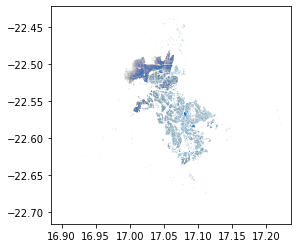

In [ ]:
b.plot()